## Anjana R-21110251

##### IVP Assigment 1- Take any colour image. Ensure that the resolution of the image is 512x512. Convert this into a gray scale image. Write  python codes to perform any 5 transformations on the image. (Example: obtain the negative of the image.) You are free to use any python package and use appropriate functions for your transformations. It will be great if you can write your own python code ( without using standard library functions). Submit your result as a .ipynb file in LMS.

In [1]:
from PIL import Image
import numpy as np

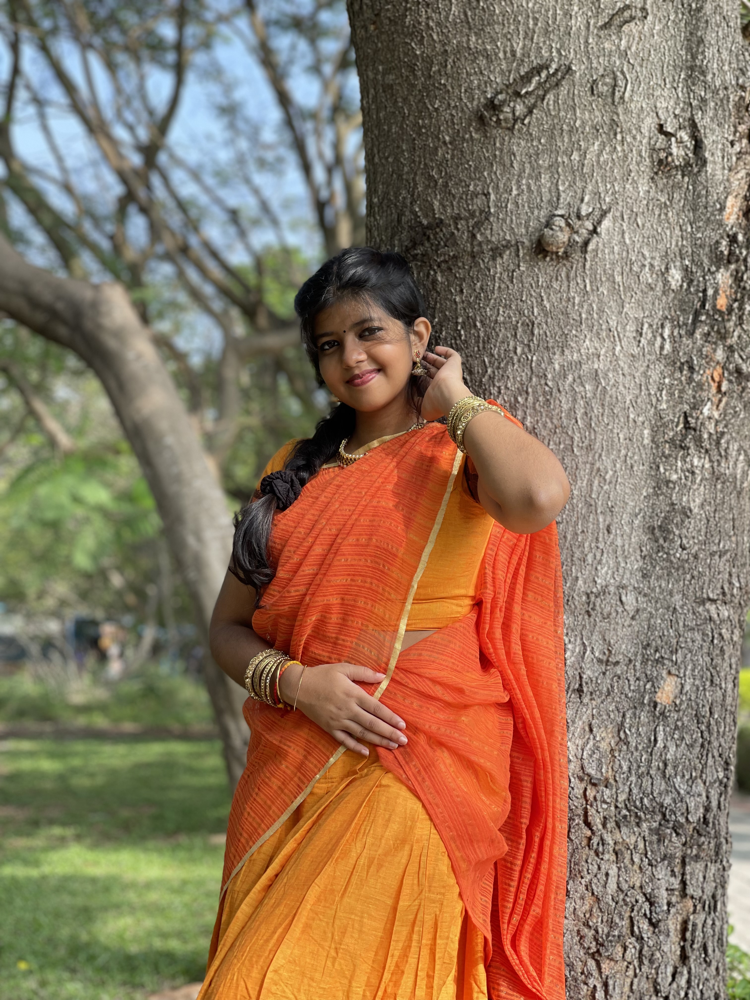

In [3]:
image_path = "A:\SNU\IVP\Assignment1\Original_img.jpeg"
original_image = Image.open(image_path)
original_image

In [6]:
original_image.size

(3024, 4032)

In [7]:
### Now to change the size to 512 x 512:

In [8]:
resized_image = original_image.resize((512, 512))

In [9]:
resized_image.size

(512, 512)

### Transformation 1: GrayScale

In [22]:
def convert_to_grayscale(image):
    width, height = image.size
    grayscale_image = Image.new('L', (width, height))

    for x in range(width):
        for y in range(height):
            r, g, b = image.getpixel((x, y))
            gray_value = int(0.299 * r + 0.587 * g + 0.114 * b)
            grayscale_image.putpixel((x, y), gray_value)

    return grayscale_image

In [27]:
grayscale_result = convert_to_grayscale(resized_image)
grayscale_result.save('grayscale_result.jpg')


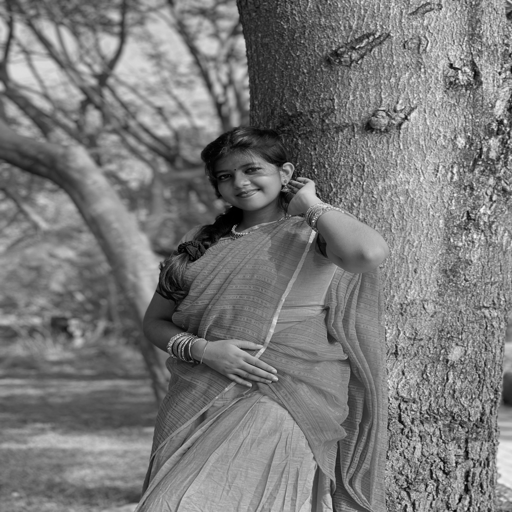

In [28]:
grayscale_result

### Transformation 2: Negative Image

In [29]:
def negative_image(image):
    image_array = np.array(image)
    negative_array = 255 - image_array
    negative_image = Image.fromarray(negative_array)
    return negative_image

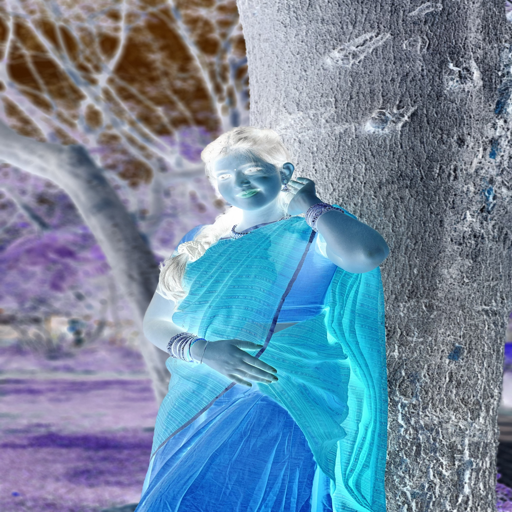

In [32]:
negative_result = negative_image(resized_image)
negative_result.save('negative_result.jpg')
negative_result

### Transformation 3: Adjust Brightness

In [58]:
def adjust_brightness(image, factor=1.5):
    width, height = image.size
    adjusted_image = Image.new('RGB', (width, height))

    for x in range(width):
        for y in range(height):
            r, g, b = image.getpixel((x, y))

            new_r = min(int(r * factor), 255)
            new_g = min(int(g * factor), 255)
            new_b = min(int(b * factor), 255)

            adjusted_image.putpixel((x, y), (new_r, new_g, new_b))

    return adjusted_image

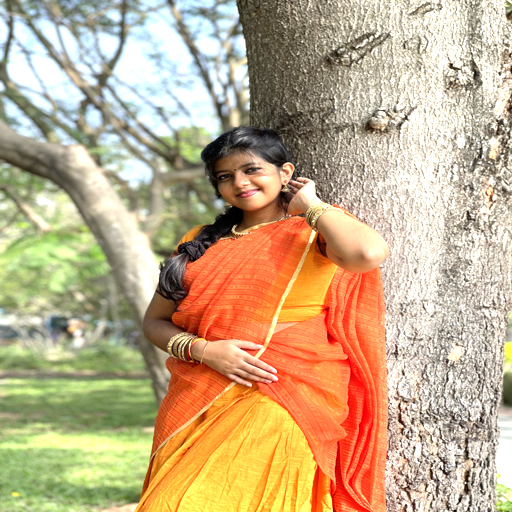

In [60]:
adjusted_result = adjust_brightness(resized_image, factor=1.5)
adjusted_result.save('adjusted_result.jpg')
adjusted_result

### Transformation 4: Flipping Image

In [61]:
from PIL import Image

def flip_horizontal(image):
    width, height = image.size
    flipped_image = Image.new('RGB', (width, height))

    for x in range(width):
        for y in range(height):
            r, g, b = image.getpixel((x, y))

            flipped_image.putpixel((width - x - 1, y), (r, g, b))

    return flipped_image

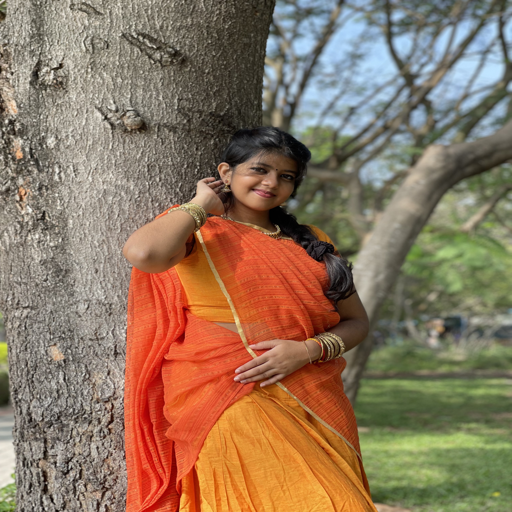

In [63]:
flipped_result = flip_horizontal(resized_image)
flipped_result.save('flipped_result.jpg')
flipped_result

### Transformation 5: Adjust Contrast

In [64]:
from PIL import Image

def adjust_contrast(image, factor=1.5):
    width, height = image.size
    adjusted_image = Image.new('RGB', (width, height))

    for x in range(width):
        for y in range(height):
            r, g, b = image.getpixel((x, y))

            new_r = min(max(int((r - 128) * factor + 128), 0), 255)
            new_g = min(max(int((g - 128) * factor + 128), 0), 255)
            new_b = min(max(int((b - 128) * factor + 128), 0), 255)

            adjusted_image.putpixel((x, y), (new_r, new_g, new_b))

    return adjusted_image


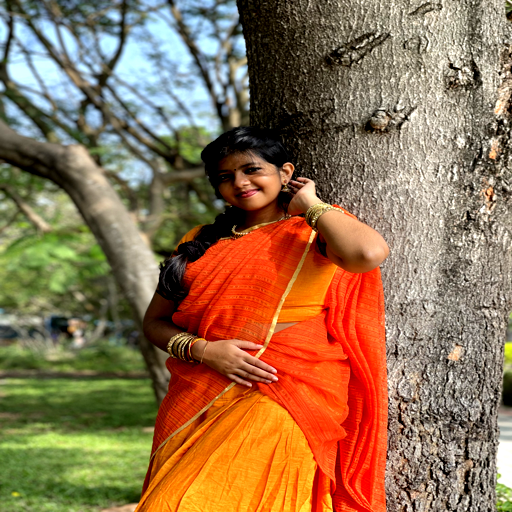

In [65]:
adjusted_contrast = adjust_contrast(resized_image, factor=1.5)
adjusted_contrast.save('adjusted_contrast.jpg')
adjusted_contrast

### Transformation 6: Cropping an Image

In [66]:
from PIL import Image

def crop_image(image, left, top, right, bottom):
    width, height = image.size
    cropped_image = Image.new('RGB', (right - left, bottom - top))

    for x in range(left, right):
        for y in range(top, bottom):
            r, g, b = image.getpixel((x, y))

            cropped_image.putpixel((x - left, y - top), (r, g, b))

    return cropped_image

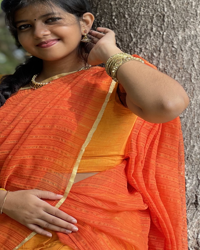

In [71]:
crop_left, crop_top, crop_right, crop_bottom = 200, 150, 400, 400
cropped_result = crop_image(resized_image, crop_left, crop_top, crop_right, crop_bottom)
cropped_result.save('cropped_result.jpg')
cropped_result

### Transformation 7: Gradient Fade

In [72]:
from PIL import Image

def gradient_fade(image, direction='vertical'):
    width, height = image.size
    faded_image = Image.new('RGB', (width, height))

    for x in range(width):
        for y in range(height):
            r, g, b = image.getpixel((x, y))

            if direction == 'vertical':
                alpha = int(255 * (y / height))
            elif direction == 'horizontal':
                alpha = int(255 * (x / width))
            else:
                raise ValueError("Invalid direction. Use 'vertical' or 'horizontal'.")
                
            faded_r = (r * alpha) // 255
            faded_g = (g * alpha) // 255
            faded_b = (b * alpha) // 255
            faded_image.putpixel((x, y), (faded_r, faded_g, faded_b))

    return faded_image

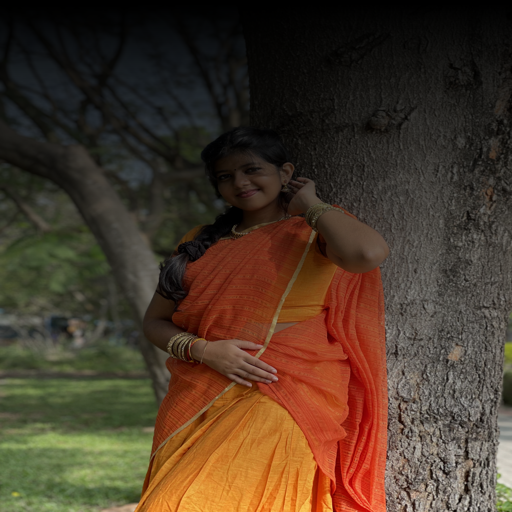

In [74]:
fade_direction = 'vertical'
gradient_faded_result = gradient_fade(resized_image, direction=fade_direction)
gradient_faded_result.save(f'gradient_faded_result_{fade_direction}.jpg')
gradient_faded_result

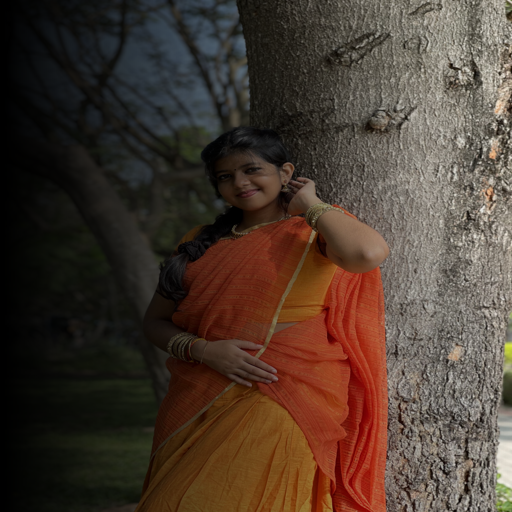

In [75]:
fade_direction = 'horizontal'
gradient_faded_result = gradient_fade(resized_image, direction=fade_direction)
gradient_faded_result.save(f'gradient_faded_result_{fade_direction}.jpg')
gradient_faded_result